In [1]:
def clearall():
    all = [var for var in globals() if var[0] != "_"]
    for var in all:
        del globals()[var]
clearall()

In [2]:
############################
######## LIBRAIRIES ########
############################
print('Importing Librairies...')
from sklearn.linear_model import LinearRegression
from colorama import Fore, Back, Style
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import seaborn as sns
import time
import os
import datetime as dt
import numpy as np
import fxcmpy
import socketio
import shelve
import talib
import pyttsx3
engine = pyttsx3.init()

print('Librairies imported\n')
print('version fxcmpy :',fxcmpy.__version__)
%matplotlib inline
plt.style.use('seaborn')
engine.say("librairie loaded")
engine.runAndWait()
print('Prêt')

Importing Librairies...
Librairies imported

version fxcmpy : 1.2.6
Prêt


In [17]:
engine.say("Ignition du Lumberjack")
engine.runAndWait() 

##############################################
######## INITIALISATION DES VARIABLES ########
##############################################


# COMPTE TEST #

TOKEN = '039add1dbe2b344ed08c518a98c7a1796f7a33c2'
server = 'demo'
user_id = 'D261219574'
compte = '01215057'
password = '3555'


'''
# COMPTE DEV #
TOKEN = '79f83cbff13d296eb6d9b6c1ed6dccd768ef925a'
server = 'demo'
user_id = 'D261219577'
compte = '01215060'
password = '3877'
'''


'''
# COMPTE POUBELLE #
TOKEN = 'a66bf5c0ec732487f4b348baf6364d3ee8784935'
server = 'demo'
user_id = 'D261219576'
compte = '01215059'
password = '8029'
'''


# minutes: 'm1' , 'm5' , 'm15' , 'm30' 
# hours: 'H1' , 'H2', 'H3', 'H4', 'H6' 'H8'
# one day: 'D1'
# one week: 'W1'
# one month: 'M1'


_number = 10000
_period = 'm1'

df = pd.DataFrame()

engine.say("בסדר")
engine.runAndWait()
print('Variables initialisées')

Variables initialisées


In [18]:

############################
######## FONCTIONS ########
###########################


def conX():
    con = fxcmpy.fxcmpy(access_token=TOKEN, log_level='error',server=server)
    if con.is_connected() == True:
        print(Fore.GREEN+'Connexion établie'+Style.RESET_ALL)
        print('Compte utilisé : ',con.get_account_ids())
    else:
        print(Fore.RED+'Connexion non établie'+Style.RESET_ALL)
    return(con)

def deconX():
    con = con.close()
    if con.is_connected() == True:
        print(Fore.GREEN+'Connexion non intérrompue'+Style.RESET_ALL)
        print('Compte utilisé : ',con.get_account_ids())
    else:
        print(Fore.RED+'Connexion intérrompue'+Style.RESET_ALL)
    return()


def scrap_hist(_ticker,_number=_number):
    data = con.get_candles(_ticker,period=_period,number=_number)
    df = pd.DataFrame(index=data.index)
    df['Open'] = (data['bidopen']+data['askopen'])/2
    df['High'] = (data['bidhigh']+data['askhigh'])/2
    df['Low'] = (data['bidlow']+data['asklow'])/2
    df['Close'] = (data['bidclose']+data['askclose'])/2
    return(df)

def scrap_close(_ticker,_number = 21):
    print('Scraping des données pour le ticker',_ticker)
    data = con.get_candles(_ticker,period=_period,number=_number)
    df = pd.DataFrame(index=data.index)
    df['Close'] = (data['bidclose']+data['askclose'])/2
    return(df)

engine.say("functions initiated")
engine.runAndWait()
print('Functions initiated')

Functions initiated


In [5]:
#########################
### CONNEXION A L'API ###
#########################

___Author___='LumberJack Jyss'
print('Global Optimized LumberJack Environment Motor for FOR_EX\nLumberJack Jyss 5780(c)')
print(Fore.BLUE,'°0Oo_D.A.G._26_oO0°')
print(Fore.YELLOW,Back.BLUE,'--- Go!em ForeX #v0.44 ---',Style.RESET_ALL)

print('')
engine.say(" Initialisation du Gaulem faurex")
engine.say("Connexion du Gaulem hà la Péh e")
engine.runAndWait()

try:
    con.is_connected() == True
    
    engine.say("already Connected")
    engine.runAndWait()
    print(Fore.GREEN+'Connexion rétablie'+Style.RESET_ALL)
    print('Compte utilisé : ',con.get_account_ids())
    print('')
    
except:
    try:
        con = conX()
        con.is_connected() == True
        print(Fore.GREEN+'Connexion établie'+Style.RESET_ALL)
        print('Compte utilisé : ',con.get_account_ids())
        engine.say("Connected")
        engine.runAndWait()
    except:
        print(Fore.RED+'Connexion non établie'+Style.RESET_ALL)
        engine.say("Not Connected, sal rass de mor, pitun cé la merd")
        engine.say("vérifi ton internet, é relance le gaulèm")
        engine.runAndWait()
        print('')
        #os._exit(0)
        con = deconX()
        time.sleep(1)
        con = conX()

Global Optimized LumberJack Environment Motor for FOR_EX
LumberJack Jyss 5780(c)
 °0Oo_D.A.G._26_oO0°
  --- Go!em ForeX #v0.44 --- 

Connexion établie
Compte utilisé :  [1215057]
Connexion établie
Compte utilisé :  [1215057]


In [19]:
%%time
INSTRUMENTS = con.get_instruments()
_compteur = -1
DICO = {}
print('Scraping des données .',end='')

for _ticker in INSTRUMENTS:
    _compteur += 1
    print('.',end='')
    #try:
    globals()['df_%s' % str(_compteur)] = scrap_hist(_ticker)
    globals()['df_%s' % str(_compteur)]['RSI'] = talib.RSI(globals()['df_%s' % str(_compteur)].Close,14)
    globals()['df_%s' % str(_compteur)]['ATR'] = \
        talib.ATR(np.asarray(globals()['df_%s' % str(_compteur)].High),\
             np.asarray(globals()['df_%s' % str(_compteur)].Low),\
                  np.asarray(globals()['df_%s' % str(_compteur)].Close))
    
    DICO[str(_ticker)] = globals()['df_%s' % str(_compteur)]

    #except:
     #   print(Fore.MAGENTA,'Problème avec le ticker',_ticker,Style.RESET_ALL)
      #  continue 
print('Scraping Ok.')
print('Shape df_0',df_0.shape)
engine.say("Wow, honey, the scrap is done!")
engine.runAndWait()

Scraping des données .....................................................................................Scraping Ok.
Shape df_0 (10000, 6)
CPU times: user 8.67 s, sys: 437 ms, total: 9.1 s
Wall time: 1min 21s


In [20]:
%%time

mise = 50000

for _ticker in INSTRUMENTS:
    _poz_long = 0
    _poz_short = 0

    _prix_open_achat = 0
    _prix_open_vente = 0
    _pnl_total = 0
    _pnl_latent = 0
    _pnl = 0
    _tp = 0
    _sl = 0

    PNL_TOTAL = [0,0,0]
    PNL_LATENT = [0,0,0]
    DATE = [0,0,0]
    OPEN = [0,0,0]
    CLOSE = [0,0,0]
    ENGULFING = [0,0,0]
    OPEN_PRICE = [0,0,0]
    CLOSE_PRICE = [0,0,0]
    PNL_TRADE = [0,0,0]
    AMPLITUDE = [0,0,0]

    df_trades = pd.DataFrame()
    _compteur = 0
    _buy = 0
    _sell = 0
    
    df = pd.DataFrame()
    df =  DICO.get(str(_ticker))

    for i in range(3,len(df)):

        _amplitude1 = abs(df.Open[i-3] - df.Close[i-3])
        _amplitude2 = abs(df.Open[i-2] - df.Close[i-2])
        
        
        

        if _poz_long == 0 and _poz_short == 0:
            if _amplitude1 > 1 * df.ATR[i-3] and _amplitude2 > 0.7 * _amplitude1 :
                
                if df.Open[i-1] <= df.Close[i-2] and\
                        df.Close[i-1] >= df.Open[i-2] and\
                            df.RSI[i-2] <= 30 and\
                            df.Close[i-3] <= df.Open[i-3] and\
                                    df.Close[i-2] <= df.Open[i-2]:

                    ENGULFING.append(1)
                    _buy += 1
                    _poz_long = 1
                    _prix_open_achat = df.Open[i]
                    _pnl_latent = (df.Close[i] - _prix_open_achat) * mise
                    _pnl = 0
                    _pnl_total += _pnl
                    _sl_achat = df.Low[i-1]
                    _amplitude = 2 * abs(df.Open[i-1] - df.Close[i-1])
                    DATE.append(df.index[i])
                    PNL_LATENT.append(_pnl_latent)
                    PNL_TOTAL.append(_pnl_total)
                    OPEN.append(1)
                    CLOSE.append(0)
                    OPEN_PRICE.append(_prix_open_achat)
                    CLOSE_PRICE.append(0)
                    PNL_TRADE.append(0)

                
                elif df.Open[i-1] >= df.Close[i-2] and\
                            df.Close[i-1] <= df.Open[i-2] and\
                                df.RSI[i-2] >= 70 and\
                                df.Close[i-3] >= df.Open[i-3] and\
                                        df.Close[i-2] >= df.Open[i-2]:

                    ENGULFING.append(-1)
                    _sell += 1
                    _poz_short = 1
                    _prix_open_vente = df.Open[i]
                    _pnl_latent = (df.Close[i] - _prix_open_vente) * mise
                    _pnl = 0
                    _pnl_total += _pnl
                    _sl_vente = df.High[i-1]
                    _amplitude = 2 * abs(df.Open[i-1] - df.Close[i-1])
                    DATE.append(df.index[i])
                    PNL_LATENT.append(_pnl_latent)
                    PNL_TOTAL.append(_pnl_total)
                    OPEN.append(1)
                    CLOSE.append(0)
                    OPEN_PRICE.append(_prix_open_vente)
                    CLOSE_PRICE.append(0)
                    PNL_TRADE.append(0)

                else:
                    ENGULFING.append(0)
                    DATE.append(df.index[i])
                    PNL_LATENT.append(_pnl_latent)
                    PNL_TOTAL.append(_pnl_total)
                    OPEN.append(0)
                    CLOSE.append(0)
                    OPEN_PRICE.append(0)
                    CLOSE_PRICE.append(0)
                    PNL_TRADE.append(0)
            else:
                ENGULFING.append(0)
                DATE.append(df.index[i])
                PNL_LATENT.append(_pnl_latent)
                PNL_TOTAL.append(_pnl_total)
                OPEN.append(0)
                CLOSE.append(0)
                OPEN_PRICE.append(0)
                CLOSE_PRICE.append(0)
                PNL_TRADE.append(0)
        
        elif _poz_long == 1:
            #if df.Close[i] >= (_amplitude/2  + df.High[i-1]) :#or df.Close[i] <= df.Low[i-1] :
            if df.Close[i] >= (_amplitude * 0.8 + _prix_open_achat) :# or df.Close[i] <= _sl_achat :
                _pnl = (df.Close[i] - _prix_open_achat) * mise
                _pnl_total += _pnl
                _pnl_latent = 0
                _poz_long = 0
                DATE.append(df.index[i])
                PNL_LATENT.append(_pnl_latent)
                PNL_TOTAL.append(_pnl_total)
                OPEN.append(0)
                CLOSE.append(1)
                ENGULFING.append(0)
                OPEN_PRICE.append(0)
                CLOSE_PRICE.append(df.Close[i])
                PNL_TRADE.append(_pnl)
            
            else :
                _pnl = (df.Close[i] - _prix_open_achat) * mise
                DATE.append(df.index[i])
                PNL_LATENT.append(_pnl_latent)
                PNL_TOTAL.append(_pnl_total)
                OPEN.append(0)
                CLOSE.append(0)
                ENGULFING.append(0)
                OPEN_PRICE.append(0)
                CLOSE_PRICE.append(0)
                PNL_TRADE.append(0)
        
        elif _poz_short == 1:
            #if df.Close[i] <= ( df.Low[i-1] - _amplitude/2) :#or df.Close[i] >= df.High[i-1] :
            if df.Close[i] <= ( _prix_open_vente - _amplitude * 0.8) :#or df.Close[i] >= _sl_vente :
                _pnl = (_prix_open_vente - df.Close[i]) * mise
                _pnl_total += _pnl
                _pnl_latent = 0
                _poz_short = 0
                DATE.append(df.index[i])
                PNL_LATENT.append(_pnl_latent)
                PNL_TOTAL.append(_pnl_total)
                OPEN.append(0)
                CLOSE.append(1)
                ENGULFING.append(0)
                OPEN_PRICE.append(0)
                CLOSE_PRICE.append(df.Close[i])
                PNL_TRADE.append(_pnl)
            
            else :
                _pnl = (_prix_open_vente - df.Close[i]) * mise
                DATE.append(df.index[i])
                PNL_LATENT.append(_pnl_latent)
                PNL_TOTAL.append(_pnl_total)
                OPEN.append(0)
                CLOSE.append(0)
                ENGULFING.append(0)
                OPEN_PRICE.append(0)
                CLOSE_PRICE.append(0)
                PNL_TRADE.append(0)


    df['Engulfing'] = ENGULFING
    df['OPEN_POZ'] = OPEN
    df['CLOSE_POZ'] = CLOSE
    df['OPEN_PRICE'] = OPEN_PRICE
    df['CLOSE_PRICE'] = CLOSE_PRICE
    df['PNL_TRADE'] = PNL_TRADE
    df['PNL_LATENT'] = PNL_LATENT
    df['PNL_TOTAL'] = PNL_TOTAL

    DICO[str(_ticker)] = df
    #print(df.shape, len(OPEN), len(CLOSE), len(ENGULFING), len(PNL_LATENT), len(PNL_TOTAL))
    print(Fore.YELLOW,'\n\nTicker',_ticker,Style.RESET_ALL)
    print(Fore.BLUE,'buy',_buy,', sell',_sell,Style.RESET_ALL)
    print(Fore.GREEN,'_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-',Style.RESET_ALL)

engine.say("okay honey, the job, is fucking done. Let's see how much we win.")
engine.runAndWait()

 

Ticker EUR/USD 
 buy 2 , sell 0 
 _-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_- 
 

Ticker USD/JPY 
 buy 1 , sell 0 
 _-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_- 
 

Ticker GBP/USD 
 buy 4 , sell 2 
 _-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_- 
 

Ticker USD/CHF 
 buy 3 , sell 2 
 _-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_- 
 

Ticker EUR/CHF 
 buy 0 , sell 2 
 _-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_- 
 

Ticker AUD/USD 
 buy 1 , sell 1 
 _-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_- 
 

Ticker USD/CAD 
 buy 1 , sell 0 
 _-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_-_

In [34]:
i = 13
print('Paire = ',INSTRUMENTS[i])
DICO.get(INSTRUMENTS[i])[(DICO.get(INSTRUMENTS[i]).OPEN_POZ != 0)|(DICO.get(INSTRUMENTS[i]).CLOSE_POZ !=0)]


Paire =  EUR/AUD


,Open,High,Low,Close,RSI,ATR,Engulfing,OPEN_POZ,CLOSE_POZ,OPEN_PRICE,CLOSE_PRICE,PNL_TRADE,PNL_LATENT,PNL_TOTAL
date,,,,,,,,,,,,,,


In [113]:
date = '2020-06-29 13:52:00'
DICO.get(INSTRUMENTS[i])[DICO.get(INSTRUMENTS[i]).index==date]

,Open,High,Low,Close,RSI,ATR,Engulfing,OPEN_POZ,CLOSE_POZ,OPEN_PRICE,CLOSE_PRICE,PNL_TRADE,PNL_LATENT,PNL_TOTAL
date,,,,,,,,,,,,,,
2020-06-29 13:52:00,1.12565,1.12605,1.12565,1.126045,29.695749,0.000233,0,0,0,0.0,0.0,0.0,0.0,0.0


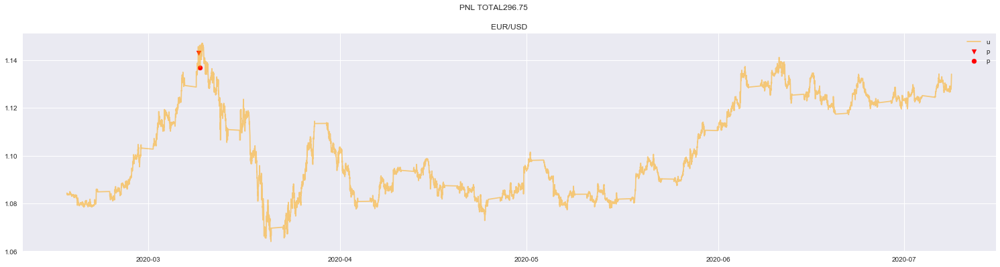

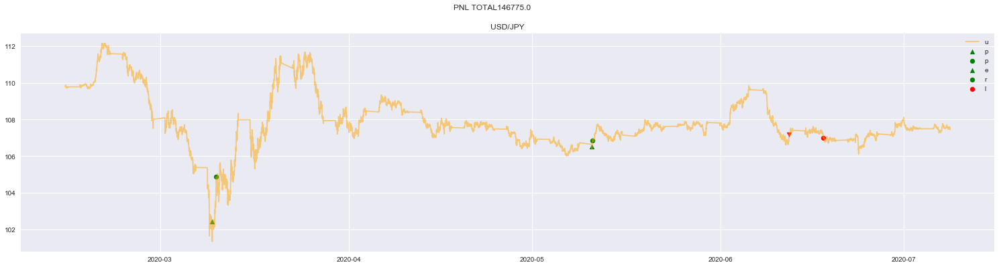

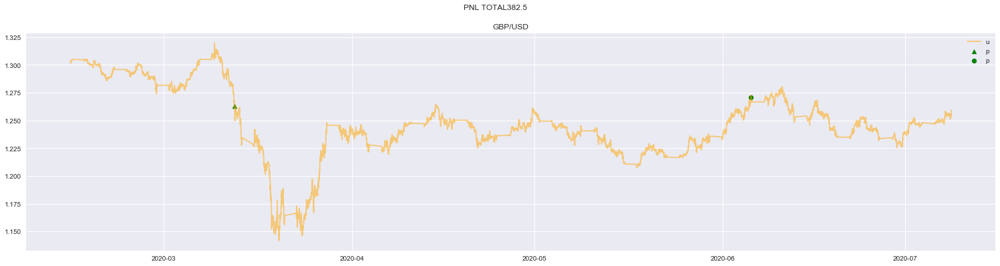

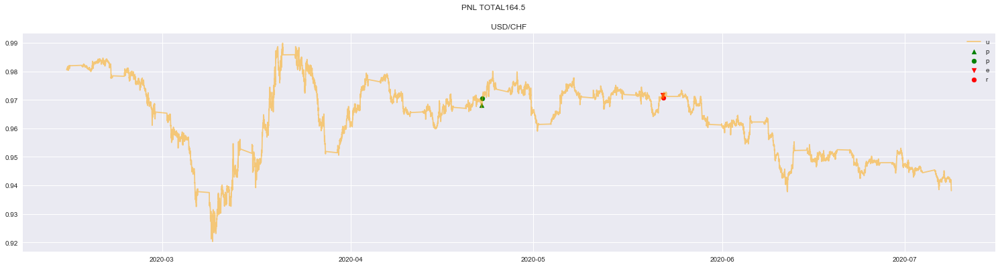

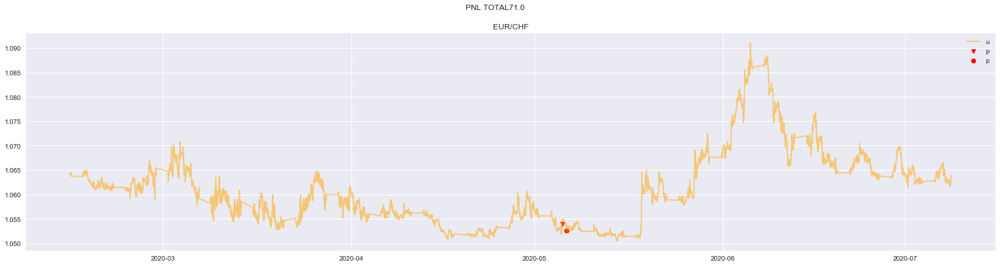

...

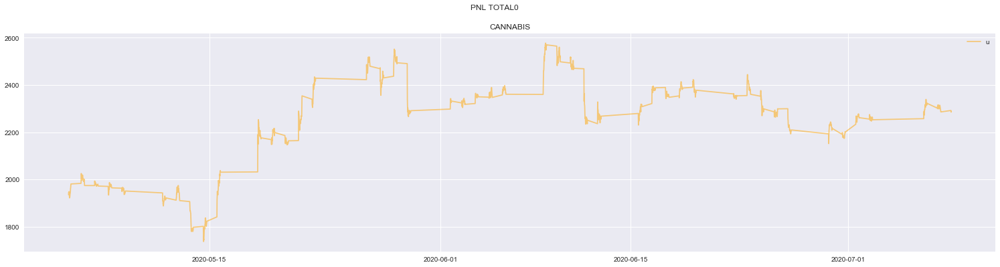

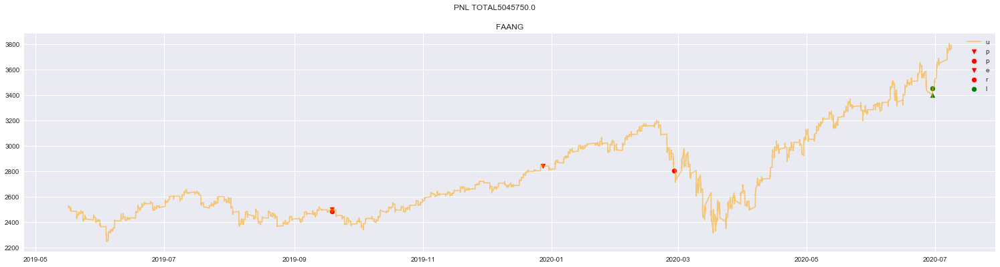

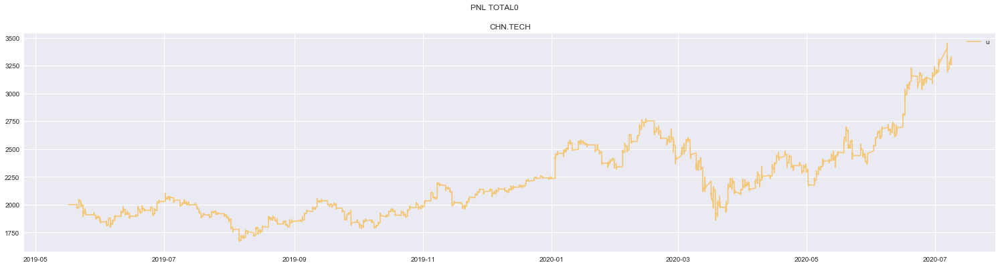

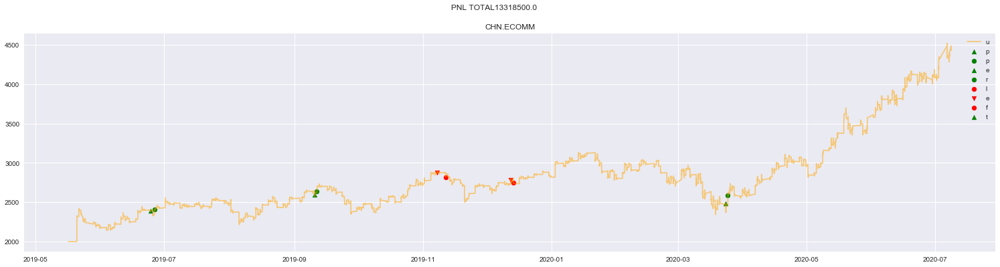

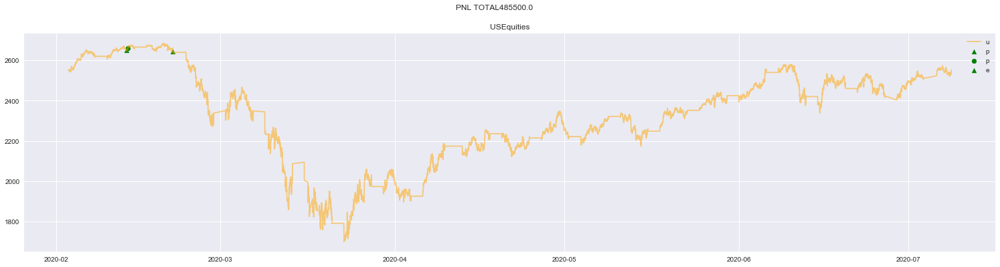

In [159]:
i = 1
for i in range(len(INSTRUMENTS)):
    p = 0
    plt.ion()
    plt.figure(figsize=(26,6))
    #plt.plot(DICO.get(INSTRUMENTS[i]).Close,c='blue',label='Close')
    plt.plot(DICO.get(INSTRUMENTS[i]).Open,c='orange',label='Open',alpha=0.5)
    plt.title(INSTRUMENTS[i])
    plt.suptitle('PNL TOTAL'+str(round(DICO.get(INSTRUMENTS[i]).PNL_TOTAL[-1],2)))
    for x in range(0,len(DICO.get(INSTRUMENTS[i]))):
        if DICO.get(INSTRUMENTS[i]).Engulfing[x] == -1 and DICO.get(INSTRUMENTS[i]).OPEN_POZ[x] == 1:
            plt.scatter(x=DICO.get(INSTRUMENTS[i]).index[x],y=DICO.get(INSTRUMENTS[i]).Open[x],marker='v',c='red')
            p = -1
        
        elif DICO.get(INSTRUMENTS[i]).Engulfing[x] == 1 and DICO.get(INSTRUMENTS[i]).OPEN_POZ[x] == 1:
            plt.scatter(x=DICO.get(INSTRUMENTS[i]).index[x],y=DICO.get(INSTRUMENTS[i]).Open[x],marker='^',c='green')
            p = 1
        
        elif p == -1 and DICO.get(INSTRUMENTS[i]).CLOSE_POZ[x] == 1:
            plt.scatter(x=DICO.get(INSTRUMENTS[i]).index[x],y=DICO.get(INSTRUMENTS[i]).Close[x],marker='o',c='red')
            p = 0
        
        elif p == 1 and DICO.get(INSTRUMENTS[i]).CLOSE_POZ[x] == 1:
            plt.scatter(x=DICO.get(INSTRUMENTS[i]).index[x],y=DICO.get(INSTRUMENTS[i]).Close[x],marker='o',c='green')
            p = 0
    plt.legend('upper_left')
    plt.pause(0.05)

In [102]:
%%time

DATE = []
SIGNAL = []
for x in INSTRUMENTS:
    for i in range(0,len(DICO.get(x))):
        if DICO.get(x).OPEN_POZ[i] == 1:
            DATE.append(DICO.get(x).index[i])
            SIGNAL.append(1)
        else:
            DATE.append(DICO.get(x).index[i])
            SIGNAL.append(0)


CPU times: user 52.7 s, sys: 387 ms, total: 53.1 s
Wall time: 53.4 s


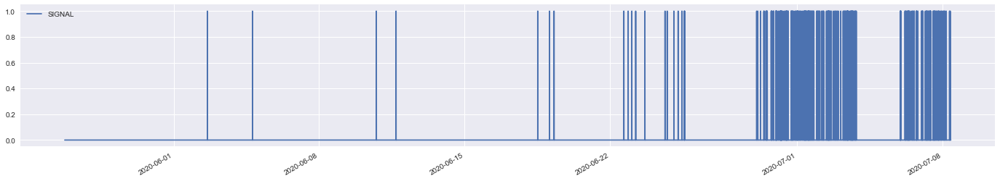

Nombre de signaux 276  pour la period en m1
CPU times: user 4.96 s, sys: 166 ms, total: 5.12 s
Wall time: 5.24 s


In [103]:
%%time
df_cumul = pd.DataFrame(index=DATE)
df_cumul['SIGNAL'] = SIGNAL
df_cumul.plot(figsize=(24,4))
plt.pause(0.05)
print('Nombre de signaux',sum(SIGNAL),' pour la period en',_period)

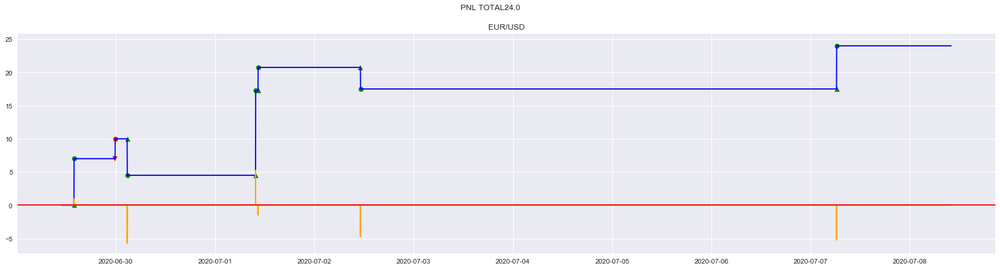

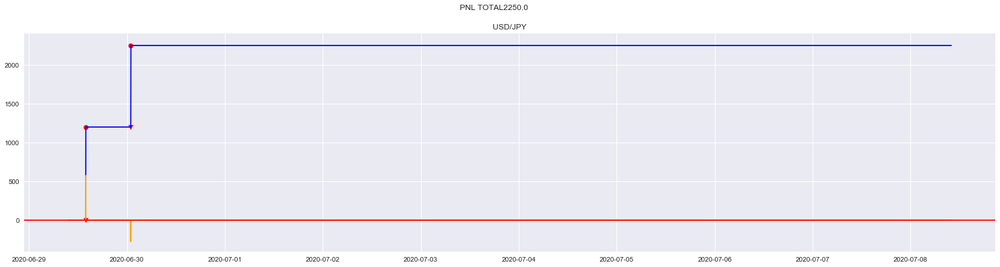

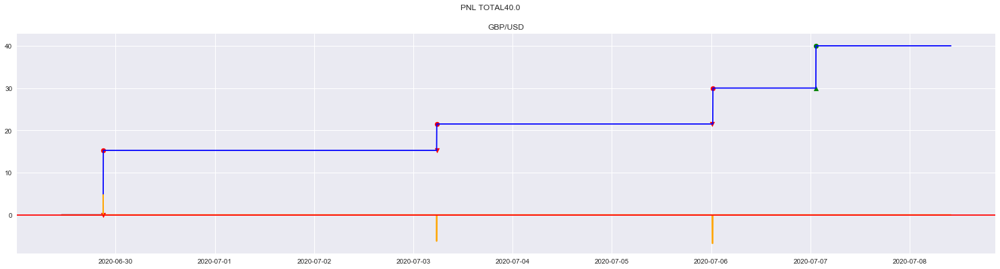

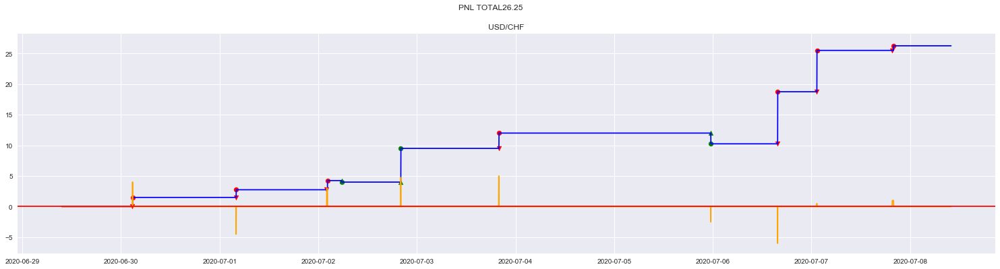

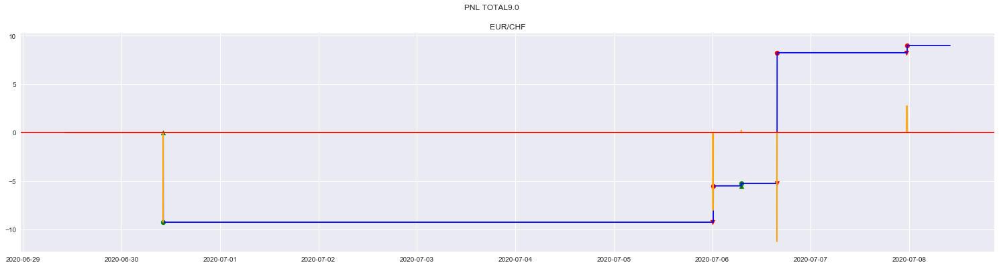

...

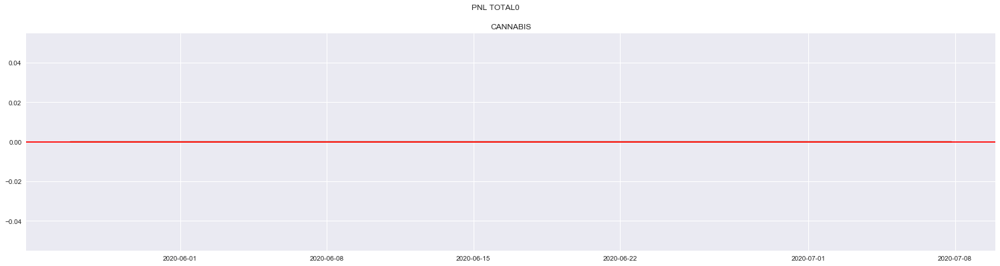

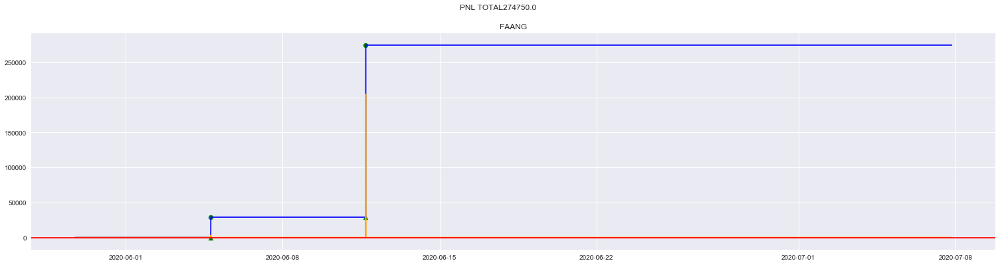

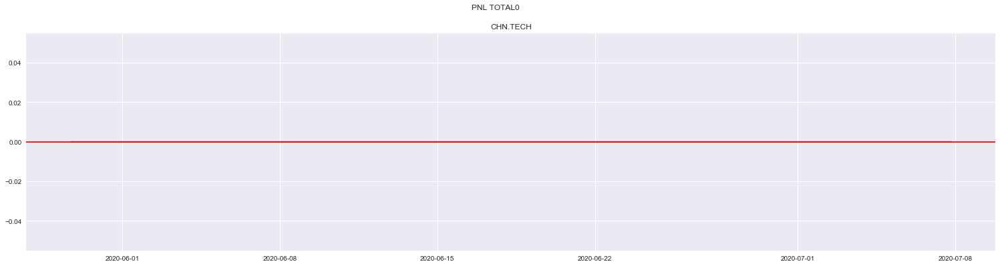

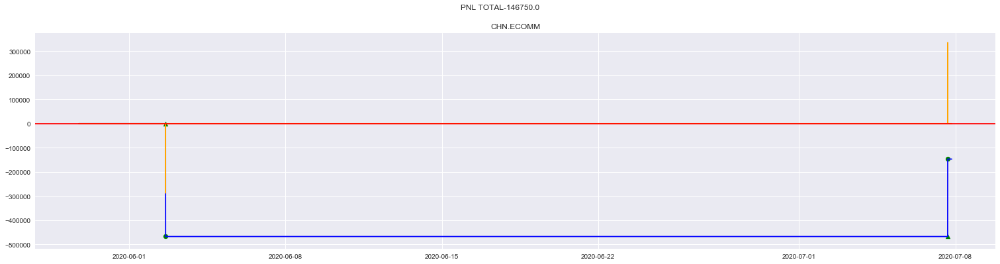

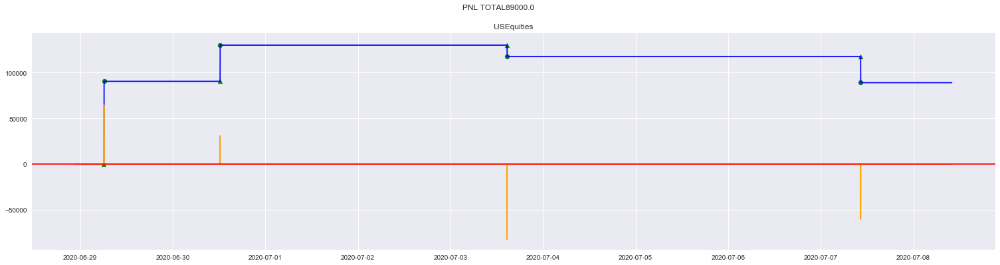

In [79]:
p = 0
for i in range(len(INSTRUMENTS)):
    plt.ion()
    plt.figure(figsize=(26,6))
    plt.plot(DICO.get(INSTRUMENTS[i]).PNL_TOTAL,c='blue',label='PNL_TOTAL')
    plt.plot(DICO.get(INSTRUMENTS[i]).PNL_LATENT,c='orange',label='PNL_LATENT')
    plt.axhline(y=0,c='red')
    plt.title(INSTRUMENTS[i])
    plt.suptitle('PNL TOTAL'+str(round(DICO.get(INSTRUMENTS[i]).PNL_TOTAL[-1],2)))
    for x in range(0,len(DICO.get(INSTRUMENTS[i]))):
        if DICO.get(INSTRUMENTS[i]).Engulfing[x] == -1 and DICO.get(INSTRUMENTS[i]).OPEN_POZ[x] == 1:
            plt.scatter(x=DICO.get(INSTRUMENTS[i]).index[x],y=DICO.get(INSTRUMENTS[i]).PNL_TOTAL[x],marker='v',c='red')
            p = -1
        
        elif DICO.get(INSTRUMENTS[i]).Engulfing[x] == 1 and DICO.get(INSTRUMENTS[i]).OPEN_POZ[x] == 1:
            plt.scatter(x=DICO.get(INSTRUMENTS[i]).index[x],y=DICO.get(INSTRUMENTS[i]).PNL_TOTAL[x],marker='^',c='green')
            p = 1
        
        elif p == -1 and DICO.get(INSTRUMENTS[i]).CLOSE_POZ[x] == 1:
            plt.scatter(x=DICO.get(INSTRUMENTS[i]).index[x],y=DICO.get(INSTRUMENTS[i]).PNL_TOTAL[x],marker='o',c='red')
            p = 0
        
        elif p == 1 and DICO.get(INSTRUMENTS[i]).CLOSE_POZ[x] == 1:
            plt.scatter(x=DICO.get(INSTRUMENTS[i]).index[x],y=DICO.get(INSTRUMENTS[i]).PNL_TOTAL[x],marker='o',c='green')
            p = 0
    plt.pause(0.05)

In [ ]:
DICO.get(INSTRUMENTS[7])

In [ ]:
for i in range(21,9970):
    #for _ticker in INSTRUMENTS:
    _compteur += 1

    #df = df.iloc[-3:,:]
    
    if df.Engulfing[i] == 1:
        engine.say("fuck, bim sa mer, we are fucking buying the market")
        engine.runAndWait()
        _buy += 1

    
    elif df.Engulfing[i] == -1:
        engine.say("fuck, bim sa mer, we are fucking selling the market")
        engine.runAndWait()
        _sell += 1

    else :
        continue
    
print(Fore.RED,'Fini',Style.RESET_ALL)
print('Buy',_buy)
print('Sell',_sell)

In [17]:
df.Engulfing.sum()

0

In [ ]:
'''
        if _amplitude1 > 1 * df.ATR[-3] and _amplitude2 > 0.7 * _amplitude1 :
            print(Fore.GREEN,_ticker,'Ok',Style.RESET_ALL)

            if df.Open[-1] < df.Close[-2] and\
                    df.Close[-1] > df.Open[-2] and\
                        df.RSI[-2] < 50 and\
                            df.Close[-3] < df.Open[-3] and\
                                df.Close[-2] < df.Open[-2]:
'''
  
'''
        elif df.Open[-1] > df.Close[-2] and\
                df.Close[-1] < df.Low[-2] and\
                    df.RSI[-2] > 50 and\
                        df.Close[-3] > df.Open[-3] and\
                            df.Close[-2] > df.Open[-2]:
                            '''